# Homework 3. Dense Prediction (50 points)
---
In this part, you will study a problem of segmentation. The goal of this assignment is to study, implement, and compare different components of dense prediction models, including **data augmentation**, **backbones**, **classifiers** and **losses**.

This assignment will require training multiple neural networks, therefore it is advised to use a **GPU** accelerator.

<font color='red'>**In this task, it is obligatory to provide accuracy plots on the training and validation datasets obtained during training, as well as examples of the work of each of the models on the images. Without plots, your work will get 0 points. Writing a report is just as important as writing code.**</font>

**<font color='red'>Before the submission please convert your notebook to .py file and check that it runs correctly. How to get .py file in Colab: File -> Download -> Download .py**

In [ ]:
# !pip install -U gdown
!pip install pytorch_lightning

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 584 kB 7.3 MB/s 
     |████████████████████████████████| 409 kB 50.5 MB/s 
     |████████████████████████████████| 140 kB 75.1 MB/s 
     |████████████████████████████████| 596 kB 50.3 MB/s 
     |████████████████████████████████| 1.1 MB 49.4 MB/s 
     |████████████████████████████████| 144 kB 55.4 MB/s 
     |████████████████████████████████| 271 kB 62.2 MB/s 
     |████████████████████████████████| 94 kB 712 kB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
# Determine the locations of auxiliary libraries and datasets.
# `AUX_DATA_ROOT` is where 'tiny-imagenet-2022.zip' is.

# Detect if we are in Google Colaboratory
try:
    import google.colab
    IN_COLAB = True
except ImportError:
    IN_COLAB = False

from pathlib import Path
if IN_COLAB:
    google.colab.drive.mount("/content/drive")
    
    # Change this if you created the shortcut in a different location
    AUX_DATA_ROOT = Path("/content/drive/My Drive/Philips/data/reconstruction_unet")
    
    assert AUX_DATA_ROOT.is_dir(), "Have you forgot to 'Add a shortcut to Drive'?"
    
    import sys
    sys.path.append(str(AUX_DATA_ROOT))
else:
    AUX_DATA_ROOT = Path(".")

Mounted at /content/drive


In [ ]:
AUX_DATA_ROOT

PosixPath('/content/drive/My Drive/Philips/data/reconstruction_unet')

In [ ]:
# pass a python variable to console in brckets {}
!ls {'"%s"' % AUX_DATA_ROOT}

C004_reconstr_5000_1_each4.npy	C004_reconstr_5000_1.npy


In [ ]:
# Uncomment and run if in Colab
#!mkdir datasets
#!cp '{AUX_DATA_ROOT}/tiny-floodnet-challenge.tar.gz' datasets/tiny-floodnet-challenge.tar.gz
#!tar -xzf datasets/tiny-floodnet-challenge.tar.gz -C datasets
#!rm datasets/tiny-floodnet-challenge.tar.gz



In [ ]:
#!ls datasets/tiny-floodnet-challenge

In [ ]:
from PIL import Image
import numpy as np

In [ ]:
!ls

drive  sample_data


In [ ]:
!pwd

/content


In [ ]:
# good_data = np.load("/content/drive/My Drive/reconstruction_unet/C004_reconstr_5000_1.npy")

In [ ]:
# bad_data = np.load("/content/drive/My Drive/reconstruction_unet/C004_reconstr_5000_1_each4.npy")

## Dataset

We will use a simplified version of a [FloodNet Challenge](http://www.classic.grss-ieee.org/earthvision2021/challenge.html).

Compared to the original challenge, our version doesn't have difficult (and rare) "flooded" labels, and the images are downsampled

<img src="https://i.imgur.com/RZuVuVp.png" />

## Assignments and grading


- **Part 1. Code**: fill in the empty gaps (marked with `#TODO`) in the code of the assignment (34 points):
    - `dataset` -- 4 points
    - `model` -- 20 points
    - `loss` -- 8 points
    - `train` -- 2 points
- **Part 2. Train and benchmark** the performance of the required models (6 points):
    - All 6 checkpoints are provided -- 3 points
    - Checkpoints have > 0.5 accuracy -- 3 points
- **Part 3. Report** your findings (10 points)
    - Each task -- 2.5 points

- **Total score**: 50 points.

For detailed grading of each coding assignment, please refer to the comments inside the files. Please use the materials provided during a seminar and during a lecture to do a coding part, as this will help you to further familiarize yourself with PyTorch. Copy-pasting the code from Google Search will get penalized.

In part 2, you should upload all your pre-trained checkpoints to your personal Google Drive, grant public access and provide a file ID, following the intructions in the notebook.

Note that for each task in part 3 to count towards your final grade, you should complete the corresponding tasks in part 2.

For example, if you are asked to compare Model X and Model Y, you should provide the checkpoints for these models in your submission, and their accuracies should be above minimal threshold.

## Part 1. Code


### `dataset`
**TODO: implement and apply data augmentations**

You'll need to study a popular augmentations library: [Albumentations](https://albumentations.ai/), and implement the requested augs. Remember that geometric augmentations need to be applied to both images and masks at the same time, and Albumentations has [native support](https://albumentations.ai/docs/getting_started/mask_augmentation/) for that.

In [ ]:
#!pip install opencv-python-headless==4.1.2.30
#!pip install -q -U albumentations

In [ ]:
# from albumentations.augmentations.transforms import RandomContrast
# from torch.utils.data import Dataset, DataLoader
# import albumentations as A
# from torchvision.transforms import ToTensor
# import os
# from PIL import Image
# import numpy as np
# import torch



# class FloodNet(Dataset):
#     """
#     Labels semantic:
#     0: Background, 1: Building, 2: Road, 3: Water, 4: Tree, 5: Vehicle, 6: Pool, 7: Grass
#     """
#     def __init__(
#         self,
#         data_path: str,
#         phase: str,
#         augment: bool,
#         img_size: int,
#     ):
#         self.num_classes = 8
#         self.data_path = data_path
#         self.phase = phase
#         self.augment = augment
#         self.img_size = img_size

#         self.items = [filename.split('.')[0] for filename in os.listdir(f'{data_path}/{phase}/image')]
        
#         # TODO: implement augmentations (3.5 points)
#         if augment:
#             # TODO:
#             # Random resize
#             # Random crop (within image borders, output size = img_size)
#             # Random rotation
#             # Random horizontal and vertical Flip
#             # Random color augmentation
#             self.transform = A.Compose([A.RandomScale(),
#                                         A.RandomCrop(img_size, img_size),
#                                         A.Rotate(),
#                                         A.HorizontalFlip(p=0.5),
#                                         A.VerticalFlip(p=0.5),
#                                         A.RandomContrast()])
#                                         #A.ColorJitter()])
            
#         else:
#         	# TODO: random crop to img_size
#             self.transform = A.RandomCrop(img_size, img_size)
        
#         self.to_tensor = ToTensor()

#     def __len__(self):
#         return len(self.items)

#     def __getitem__(self, index):
#         image = np.asarray(Image.open(f'{self.data_path}/{self.phase}/image/{self.items[index]}.jpg'))
#         mask = np.asarray(Image.open(f'{self.data_path}/{self.phase}/mask/{self.items[index]}.png'))
        
#         if self.phase == 'train':
#         	# TODO: apply transform to both image and mask (0.5 points)
#           transformed = self.transform(image=image, mask=mask)
#           image = transformed['image']
#           mask = transformed['mask']
        
#         image = self.to_tensor(image.copy())
#         mask = torch.from_numpy(mask.copy()).long()

#         if self.phase == 'train':
#             assert isinstance(image, torch.FloatTensor) and image.shape == (3, self.img_size, self.img_size)
#             assert isinstance(mask, torch.LongTensor) and mask.shape == (self.img_size, self.img_size)

#         return image, mask

In [ ]:
from albumentations.augmentations.transforms import RandomContrast
from torch.utils.data import Dataset, DataLoader
import albumentations as A
from torchvision.transforms import ToTensor
import os
from PIL import Image
import numpy as np
import torch



class FloodNet(Dataset):
    """
    Labels semantic:
    0: Background, 1: Building, 2: Road, 3: Water, 4: Tree, 5: Vehicle, 6: Pool, 7: Grass
    """
    def __init__(
        self,
        data_path_good: str,
        data_path_bad: str,
        phase: str,
        augment: bool,
        img_size: int,
    ):
        self.data_path_good = data_path_good
        self.data_path_bad = data_path_bad
        self.images_good = np.load(self.data_path_good, mmap_mode= 'r') #N x H x W
        self.images_bad = np.load(self.data_path_bad, mmap_mode = 'r') #N x H x W
        self.phase = phase
        self.augment = augment
        self.img_size = 256
        
        # TODO: implement augmentations (3.5 points)
        if augment:

          self.transform = A.RandomCrop(img_size, img_size)
            # self.transform = A.Compose([
            #                             A.RandomCrop(img_size, img_size),
            #                             A.Rotate(),
            #                             A.HorizontalFlip(p=0.5),
            #                             A.VerticalFlip(p=0.5),
            #                             #A.RandomContrast()
            #                             ])
            #                             #A.ColorJitter()])
            
        else:
        	# TODO: random crop to img_size
            self.transform = A.RandomCrop(img_size, img_size)
        self.to_tensor = ToTensor()

    def __len__(self):
        if self.phase == 'train':
          return 2300
        if self.phase == 'test':
          return 200
        #return len(self.images_good)

    def __getitem__(self, index):
        if self.phase == 'train':
          ind = 200
        if self.phase == 'test':
          ind = 0
        img_good = self.images_good[ind+index, :, :]
        img_bad = self.images_bad[ind+index, :, :]
        #print(img_torch_good)
        img_torch_good = torch.squeeze(self.to_tensor(img_good))#H x W
        img_torch_bad = torch.squeeze(self.to_tensor(img_bad)) #H x W

         # Ch x H x W
        #img_torch_good = torch.unsqueeze(img_torch_good, dim =0) # B x Ch x H x W

        #img_torch_bad = torch.unsqueeze(img_torch_bad, dim =0) # Ch x H x W
        #img_torch_bad = torch.unsqueeze(img_torch_bad, dim =0) # B x Ch x H x W

        img_inp = img_torch_bad
        img_out = img_torch_good
        #if self.phase == 'train':
        	# TODO: apply transform to both image and mask (0.5 points)
        transformed = self.transform(image=img_inp, mask=img_out)
        img_inp = transformed['image']
        img_out = transformed['mask']
        img_inp = torch.unsqueeze(img_inp, dim =0)
        #img_out = torch.unsqueeze(img_out, dim =0)
        return img_inp, img_out

In [ ]:
'''data = FloodNet(data_path_good='/content/drive/My Drive/reconstruction_unet/C004_reconstr_5000_1.npy', 
                data_path_bad='/content/drive/My Drive/reconstruction_unet/C004_reconstr_5000_1_each4.npy', 
                phase='train', augment=True, img_size=256)'''

data = FloodNet(data_path_good='/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1.npy', 
                data_path_bad='/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1_each4.npy', 
                phase='train', augment=True, img_size=256)

In [ ]:
inp, out = data[1]

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:133: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:178.)
  img = torch.from_numpy(pic.transpose((2, 0, 1))).contiguous()


In [ ]:
print(inp == out)

tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]])


In [ ]:
out

tensor([[ 5.2243e-03,  4.4391e-03,  5.0535e-03,  ..., -5.1126e-04,
         -4.7304e-04, -4.9183e-04],
        [ 4.9998e-03,  5.0406e-03,  4.0195e-03,  ..., -5.5176e-04,
         -4.4743e-04, -4.7546e-04],
        [ 5.1232e-03,  5.2311e-03,  4.1737e-03,  ..., -6.7907e-04,
         -5.6388e-04, -4.7680e-04],
        ...,
        [ 5.8143e-03,  6.4713e-03,  5.6687e-03,  ..., -6.9511e-05,
          2.3377e-04,  1.9569e-04],
        [ 5.9186e-03,  6.6101e-03,  5.5876e-03,  ...,  5.2624e-05,
          2.7567e-05,  3.9548e-05],
        [ 5.9954e-03,  6.5610e-03,  5.3799e-03,  ..., -8.5680e-05,
          2.2657e-04,  7.3735e-05]])

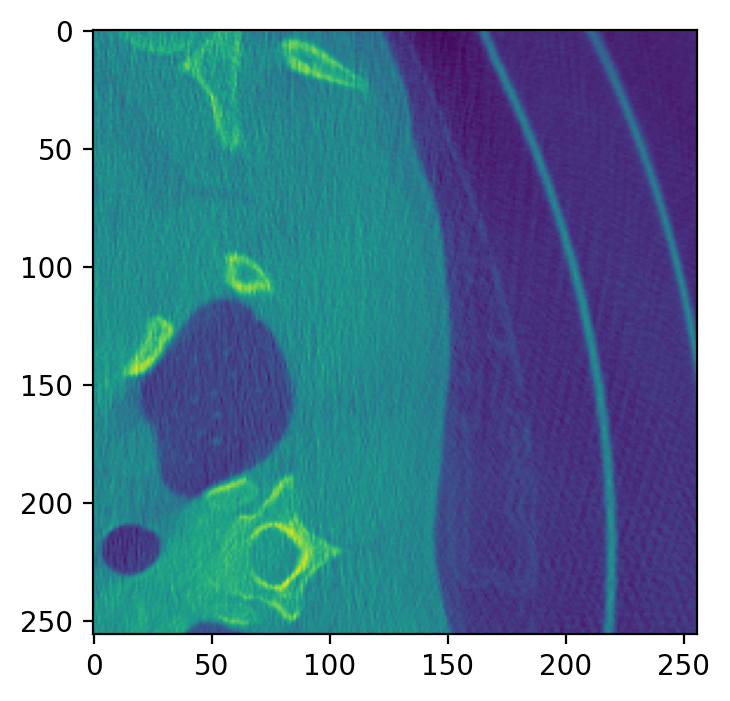

In [ ]:
import matplotlib.pyplot as plt
plt.figure(dpi =200)
plt.imshow(np.squeeze(inp))

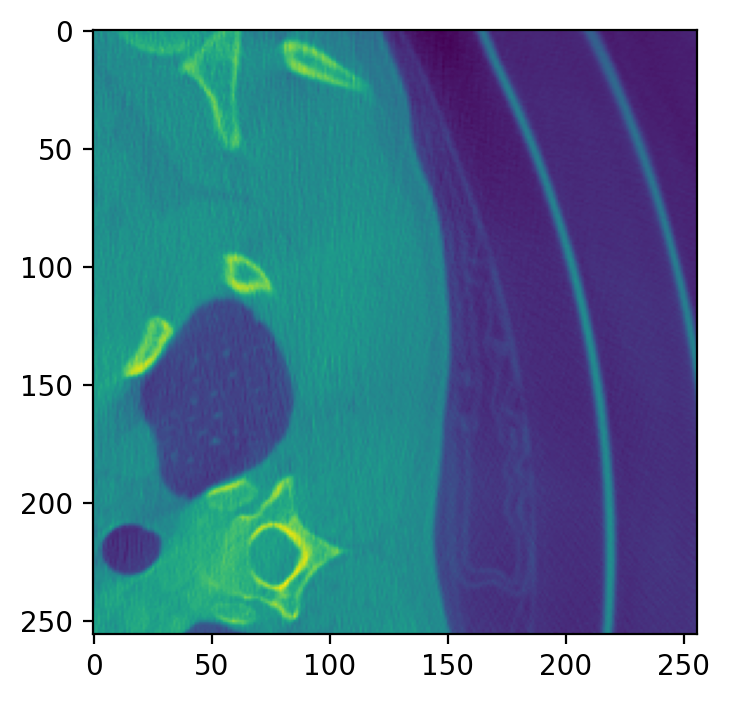

In [ ]:
import matplotlib.pyplot as plt
plt.figure(dpi =200)
plt.imshow(np.squeeze(out))

In [ ]:
for item in data:
  print(item[0].shape)
  break

torch.Size([1, 256, 256])


### `model`
**TODO: Implement the required models.**

Typically, all segmentation networks consist of an encoder and decoder. Below is a scheme for a popular DeepLab v3 architecture:

<img src="https://i.imgur.com/cdlkxvp.png" />

The encoder consists of a convolutional backbone, typically with extensive use of convs with dilations (atrous convs) and a head, which helps to further boost the receptive field. As you can see, the general idea for the encoders is to have as big of a receptive field, as possible.

The decoder either does upsampling with convolutions (similarly to the scheme above, or to UNets), or even by simply interpolating the outputs of the encoder.

In this assignment, you will need to implement **UNet** and **DeepLab** models. Example UNet looks like this:

<img src="https://i.imgur.com/uVdcE4e.png" />

For **DeepLab** model we will have three variants for backbones: **ResNet18**, **VGG11 (with BatchNorm)**, and **MobileNet v3 (small).** Use `torchvision.models` to obtain pre-trained versions of these backbones and simply extract their convolutional parts. To familiarize yourself with **MobileNet v3** model, follow this [link](https://paperswithcode.com/paper/searching-for-mobilenetv3).

We will also use **Atrous Spatial Pyramid Pooling (ASPP)** head. Its scheme can be seen in the DeepLab v3 architecture above. ASPP is one of the blocks which greatly increases the spatial size of the model, and hence boosts the model's performance. For more details, you can refer to this [link](https://paperswithcode.com/method/aspp).

In [ ]:
import torch
from torch import nn
from torch.nn import functional as F
from torchvision import models



class UNet(nn.Module):
    """
    TODO: 8 points

    A standard UNet network (with padding in covs).

    For reference, see the scheme in materials/unet.png
    - Use batch norm between conv and relu
    - Use max pooling for downsampling
    - Use conv transpose with kernel size = 3, stride = 2, padding = 1, and output padding = 1 for upsampling
    - Use 0.5 dropout after concat

    Args:
      - num_classes: number of output classes
      - min_channels: minimum number of channels in conv layers
      - max_channels: number of channels in the bottleneck block
      - num_down_blocks: number of blocks which end with downsampling

    The full architecture includes downsampling blocks, a bottleneck block and upsampling blocks

    You also need to account for inputs which size does not divide 2**num_down_blocks:
    interpolate them before feeding into the blocks to the nearest size which divides 2**num_down_blocks,
    and interpolate output logits back to the original shape
    """
    def __init__(self, 
                 num_classes=1,
                 min_channels=32,
                 max_channels=512, 
                 num_down_blocks=4):
        super(UNet, self).__init__()
        self.num_classes = num_classes
        # TODO
        self.num_down_blocks = num_down_blocks
        self.double_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=1, out_channels=min_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=min_channels, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True))
        
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.double_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True))
   
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.double_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True))
        
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.double_conv4 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True))
        
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.bottleneck = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True))
        
        self.up1 = nn.ConvTranspose2d(512, 512, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.drop1 = nn.Dropout2d()

        self.dec_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=1024, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True))
        
        self.up2 = nn.ConvTranspose2d(256, 256, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.drop2 = nn.Dropout2d()

        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True))
        
        self.up3 = nn.ConvTranspose2d(128, 128, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.drop3 = nn.Dropout2d()

        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True))
        
        self.up4 = nn.ConvTranspose2d(64, 64, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.drop4 = nn.Dropout2d()

        self.dec_conv4 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=64, out_channels=32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True))
        
        self.lst_conv = nn.Conv2d(in_channels=32, out_channels=1, kernel_size=1)
        #self.sigm = nn.Sigmoid()

    def forward(self, inputs):
        # TODO
        _, _, h, w = inputs.shape    
        h_new = h - h%(2**self.num_down_blocks)
        w_new = w - w%(2**self.num_down_blocks)
        inputs_new = F.interpolate(inputs, size=(h_new, w_new), mode='bilinear')

        x1 = self.double_conv1(inputs_new)
        x2 = self.pool1(x1)
        x3 = self.double_conv2(x2)
        x4 = self.pool2(x3)
        x5 = self.double_conv3(x4)
        x6 = self.pool3(x5)
        x7 = self.double_conv4(x6)
        x8 = self.pool4(x7)
        x = self.bottleneck(x8)
        x = self.up1(x)
        x = torch.cat([x, x7], dim=1)
        x = self.drop1(x)
        x = self.dec_conv1(x)
        x = self.up2(x)
        x = torch.cat([x, x5], dim=1)
        x = self.drop2(x)
        x = self.dec_conv2(x)
        x = self.up3(x)
        x = torch.cat([x, x3], dim=1)
        x = self.drop3(x)
        x = self.dec_conv3(x)
        x = self.up4(x)
        x = torch.cat([x, x1], dim=1)
        x = self.drop4(x)
        x = self.dec_conv4(x)
        x = self.lst_conv(x)
        #x = self.sigm(x)
        
        logits = F.interpolate(x, size=(h, w), mode='bilinear')

        assert logits.shape == (inputs.shape[0], self.num_classes, inputs.shape[2], inputs.shape[3]), 'Wrong shape of the logits'
        return logits


class DeepLab(nn.Module):
    """
    TODO: 6 points

    (simplified) DeepLab segmentation network.
    
    Args:
      - backbone: ['resnet18', 'vgg11_bn', 'mobilenet_v3_small'],
      - aspp: use aspp module
      - num classes: num output classes

    During forward pass:
      - Pass inputs through the backbone to obtain features
      - Apply ASPP (if needed)
      - Apply head
      - Upsample logits back to the shape of the inputs
    """
    def __init__(self, backbone, aspp, num_classes):
        super(DeepLab, self).__init__()
        self.backbone = backbone
        self.num_classes = num_classes
        self.init_backbone()

        if aspp:
            self.aspp = ASPP(self.out_features, 256, [12, 24, 36])

        self.head = DeepLabHead(self.out_features, num_classes)

    def init_backbone(self):
        # TODO: initialize an ImageNet-pretrained backbone
        if self.backbone == 'resnet18':
            self.model = nn.Sequential(*list(models.resnet18(pretrained=True).children())[:-2])
            self.out_features = 512 # TODO: number of output features in the backbone

        elif self.backbone == 'vgg11_bn':
            self.model = models.vgg11_bn(pretrained=True).features
            self.out_features = 512 # TODO

        elif self.backbone == 'mobilenet_v3_small':
            self.model = models.mobilenet_v3_small(pretrained=True).features
            self.out_features = 576 # TODO

    def _forward(self, x):
        # TODO: forward pass through the backbone
        if self.backbone == 'resnet18':
            x = self.model(x)

        elif self.backbone == 'vgg11_bn':
            x = self.model(x)

        elif self.backbone == 'mobilenet_v3_small':
            x = self.model(x)

        return x

    def forward(self, inputs):
        x = self._forward(inputs) # TODO
        _, _, h, w = inputs.shape    

        try:
            x = self.aspp(x)
        except:
            pass
        
        logits = self.head(x)
        logits = F.interpolate(logits, size=(h, w), mode='bilinear')

        assert logits.shape == (inputs.shape[0], self.num_classes, inputs.shape[2], inputs.shape[3]), 'Wrong shape of the logits'
        return logits


class DeepLabHead(nn.Sequential):
    def __init__(self, in_channels, num_classes):
        super(DeepLabHead, self).__init__(
            nn.Conv2d(in_channels, in_channels, 3, padding=1, bias=False),
            nn.BatchNorm2d(in_channels),
            nn.ReLU(),
            nn.Conv2d(in_channels, num_classes, 1)
        )


class ASPP(nn.Module):
    """
    TODO: 8 points

    Atrous Spatial Pyramid Pooling module
    with given atrous_rates and out_channels for each head
    Description: https://paperswithcode.com/method/aspp
    
    Detailed scheme: materials/deeplabv3.png
      - "Rates" are defined by atrous_rates
      - "Conv" denotes a Conv-BN-ReLU block
      - "Image pooling" denotes a global average pooling, followed by a 1x1 "conv" block and bilinear upsampling
      - The last layer of ASPP block should be Dropout with p = 0.5

    Args:
      - in_channels: number of input and output channels
      - num_channels: number of output channels in each intermediate "conv" block
      - atrous_rates: a list with dilation values
    """
    def __init__(self, in_channels, num_channels, atrous_rates):
        super(ASPP, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=in_channels, out_channels=num_channels, kernel_size=1)
        self.b1 = nn.BatchNorm2d(num_channels)
        self.r1 = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(in_channels=in_channels, out_channels=num_channels, kernel_size=3, padding=atrous_rates[0], dilation=atrous_rates[0])
        self.b2 = nn.BatchNorm2d(num_channels)
        self.r2 = nn.ReLU(inplace=True)
        self.conv3 = nn.Conv2d(in_channels=in_channels, out_channels=num_channels, kernel_size=3, padding=atrous_rates[1], dilation=atrous_rates[1])
        self.b3 = nn.BatchNorm2d(num_channels)
        self.r3 = nn.ReLU(inplace=True)
        self.conv4 = nn.Conv2d(in_channels=in_channels, out_channels=num_channels, kernel_size=3, padding=atrous_rates[2], dilation=atrous_rates[2])
        self.b4 = nn.BatchNorm2d(num_channels)
        self.r4 = nn.ReLU(inplace=True)
        self.pool = nn.AdaptiveAvgPool2d(1)
        self.conv5 = nn.Conv2d(in_channels=in_channels, out_channels=num_channels, kernel_size=1)
        self.b5 = nn.BatchNorm2d(num_channels)
        self.r5 = nn.ReLU(inplace=True)

        self.last_conv = nn.Conv2d(in_channels=in_channels*5, out_channels=num_channels, kernel_size=1)
        self.drop = nn.Dropout2d()  


    def forward(self, x):
        # TODO: forward pass through the ASPP module

        _, _, h, w = x.shape

        x1 = self.conv1(x)
        x1 = self.b1(x1)
        x1 = self.r1(x1)
        x2 = self.conv2(x)
        x2 = self.b2(x2)
        x2 = self.r2(x2)
        x3 = self.conv3(x)
        x3 = self.b3(x3)
        x3 = self.r3(x3)
        x4 = self.conv4(x)
        x4 = self.b4(x4)
        x4 = self.r4(x4)
        x5 = self.pool(x)
        x5 = self.conv5(x5)
        x5 = self.b5(x5)
        x5 = self.r5(x5)
        x5 = F.interpolate(x5, size=(h, w), mode='bilinear')
        x = torch.cat([x1, x2, x3, x4, x5], dim=1)
        x = self.last_conv(x)
        x = self.drop(x)
        
        assert res.shape[1] == x.shape[1], 'Wrong number of output channels'
        assert res.shape[2] == x.shape[2] and res.shape[3] == x.shape[3], 'Wrong spatial size'
        return res

### `loss`
**TODO: implement test losses.**

For validation, we will use three metrics. 
- Mean intersection over union: **mIoU**,
- Mean class accuracy: **classAcc**,
- Accuracy: **Acc**.

To calculate **IoU**, use this formula for binary segmentation masks for each class, and then average w.r.t. all classes:

$$ \text{IoU} = \frac{ \text{area of intersection} }{ \text{area of union} } = \frac{ \| \hat{m} \cap m  \| }{ \| \hat{m} \cup m \| }, \quad \text{$\hat{m}$ — predicted binary mask},\ \text{$m$ — target binary mask}.$$

Generally, we want our models to optimize accuracy since this implies that it makes little mistakes. However, most of the segmentation problems have imbalanced classes, and therefore the models tend to underfit the rare classes. Therefore, we also need to measure the mean performance of the model across all classes (mean IoU or mean class accuracy). In reality, these metrics (not the accuracy) are the go-to benchmarks for segmentation models.

In [ ]:
!pip install piq

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 139 kB 9.6 MB/s 


In [ ]:
from piq import ssim, SSIMLoss, psnr, haarpsi, vsi, ms_ssim


def norm(x, a=1, b=1, eps =1e-12):
    a = torch.min(x)#.cpu().detacth().numpy()
    b = torch.max(x)#.cpu().detacth().numpy()
    return (x-a).div(b-a+eps)#.expand_as(input)
    #return (x+0.0043245163)/(0.019309828+0.0043245163)

def norm2(input, a=1, b =1,  p=1, dim=1, eps=1e-12):
    input = input / input.norm(p)
    input = input.clamp(min=eps, max =1-eps)
    return input
    #return input.clamp(min=0, max=1)

def PSNR(x,y, a=1,b=1, data_range = 1.0): #x -- preds, y -- masks
    x,y = norm(x,a,b), norm(y,a,b)
    return psnr(x,y, data_range = data_range)

def SSIM(x, y, a=1,b=1,data_range = 1.0):
    x,y = norm(x,a,b), norm(y,a,b)
    return ssim(x, y, data_range = data_range)

def HaarPSI(x,y,a=1,b=1, data_range = 1.0):
    x,y = norm(x,a,b), norm(y,a,b)
    return haarpsi(x,y,data_range=data_range)

def VSI(x, y,a=1,b=1, data_range = 1.0):
    x,y = norm(x,a,b), norm(y,a,b)
    return vsi(x, y, data_range=data_range)

In [ ]:
a =torch.tensor([4.,5.,6.,3., 0., -10.], requires_grad =True)
b =torch.tensor([0.,0.,0.,0., 0., -10.], requires_grad =True)
print(a.clamp(min= 0+1e-12, max =1-1e-12))
print(a/a.norm(2, 0, True))
print(a/a.norm(2, 0, True).clamp(min=0+1e-12))
print(a.clamp(min=0+1e-12,max =1-1e-12))

a=a-b
print('aaaaaa')

print(a.clamp(min= 0+1e-12, max =1-1e-12))
print(a/a.norm(2, 0, True))
print((a)/a.norm(2, 0, True).clamp(min=0+1e-12,max =1-1e-12))
print(a.grad)

tensor([1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e-12, 1.0000e-12],
       grad_fn=<ClampBackward1>)
tensor([ 0.2933,  0.3666,  0.4399,  0.2200,  0.0000, -0.7332],
       grad_fn=<DivBackward0>)
tensor([ 0.2933,  0.3666,  0.4399,  0.2200,  0.0000, -0.7332],
       grad_fn=<DivBackward0>)
tensor([1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e-12, 1.0000e-12],
       grad_fn=<ClampBackward1>)
aaaaaa
tensor([1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e-12, 1.0000e-12],
       grad_fn=<ClampBackward1>)
tensor([0.4313, 0.5392, 0.6470, 0.3235, 0.0000, 0.0000],
       grad_fn=<DivBackward0>)
tensor([4., 5., 6., 3., 0., 0.], grad_fn=<DivBackward0>)
None


/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:1104: UserWarning: The .grad attribute of a Tensor that is not a leaf Tensor is being accessed. Its .grad attribute won't be populated during autograd.backward(). If you indeed want the .grad field to be populated for a non-leaf Tensor, use .retain_grad() on the non-leaf Tensor. If you access the non-leaf Tensor by mistake, make sure you access the leaf Tensor instead. See github.com/pytorch/pytorch/pull/30531 for more informations. (Triggered internally at  aten/src/ATen/core/TensorBody.h:475.)
  return self._grad


In [ ]:
a =torch.tensor([4.,5.,6.,3., 0., -10.], requires_grad =True)
b =torch.tensor([0.,0.,0.,0., 0., -10.], requires_grad =False)
print((b-a)/b)

tensor([-inf, -inf, -inf, -inf, nan, -0.], grad_fn=<DivBackward0>)


In [ ]:
from piq import VSILoss, HaarPSILoss

In [ ]:
#Dataset_good = np.load('/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1.npy', mmap_mode= 'r')
#Dataset_bad = np.load('/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1_each4.npy', mmap_mode= 'r')

In [ ]:
#print(np.max(Dataset_good))
#print(np.min(Dataset_good))
#print(np.max(Dataset_bad))
#print(np.min(Dataset_bad))

0.016789151
-0.0032605808
0.019309828
-0.0043245163


In [ ]:
def calc_val_loss(preds, masks, num_classes=1): 
    #preds = torch.argmax(preds, dim=1)

    #preds = F.one_hot(preds, num_classes)
    #masks = F.one_hot(masks, num_classes)
    
    #max1 = torch.max(masks)
    #max2 = torch.max(preds)
    #max_ = max(max1, max2)
    
    #min1 = torch.min(masks)
    #min2 = torch.min(preds)
    #min_ = min(min1, min2)
    Max_=1.0

    max_, min_=1,1

    masks = torch.unsqueeze(masks, 1)

    psnr = PSNR(preds, masks,min_, max_, data_range = Max_)
    ssim = SSIM(preds, masks, min_, max_,data_range = Max_)
    haarpsi = HaarPSI(preds, masks,min_, max_, data_range = Max_)
    vsi = VSI(preds, masks,min_, max_, data_range = Max_)
    
    
    # Output shapes: B x num_classes

    #assert isinstance(psnr, torch.Tensor), 'Output should be a tensor'
    #assert isinstance(union, torch.Tensor), 'Output should be a tensor'
    #assert isinstance(target, torch.Tensor), 'Output should be a tensor'

    assert psnr.shape == ssim.shape == vsi.shape== haarpsi.shape, 'Wrong output shape'
    #assert psnr.shape[0] == ssim.shape[0] #and union.shape[1] == num_classes, 'Wrong output shape'

    return psnr, ssim, haarpsi, vsi
'''
def calc_val_loss(intersection, union, target, eps = 1e-7):
    mean_iou = (intersection / (union + eps)).mean() # TODO: calc mean class iou
    mean_class_rec = (intersection / (target + eps)).mean() # TODO: calc mean class recall
    mean_acc = (intersection.sum(dim=1) / (target.sum(dim=1) + eps)).mean() # TODO: calc mean accuracy
    #print(mean_acc)
    return mean_iou, mean_class_rec, mean_acc
    '''

'\ndef calc_val_loss(intersection, union, target, eps = 1e-7):\n    mean_iou = (intersection / (union + eps)).mean() # TODO: calc mean class iou\n    mean_class_rec = (intersection / (target + eps)).mean() # TODO: calc mean class recall\n    mean_acc = (intersection.sum(dim=1) / (target.sum(dim=1) + eps)).mean() # TODO: calc mean accuracy\n    #print(mean_acc)\n    return mean_iou, mean_class_rec, mean_acc\n    '

### `train`
**TODO: define optimizer and learning rate scheduler.**

You need to experiment with different optimizers and schedulers and pick one of each which works the best. Since the grading will be partially based on the validation performance of your models, we strongly advise doing some preliminary experiments and pick the configuration with the best results.

In [ ]:
# Copyright The PyTorch Lightning team.
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Modifications Copyright Skoltech Deep Learning Course.

import torch
import torch.nn.functional as F
import pytorch_lightning as pl
from torch.utils.data import DataLoader


class SegModel(pl.LightningModule):
    def __init__(
        self,
        model: str,
        backbone: str,
        aspp: bool,
        augment_data: bool,
        optimizer: str = 'default',
        scheduler: str = 'default',
        lr: float = None,
        batch_size: int = 4,
        #data_path_good: str = '/content/drive/My Drive/reconstruction_unet/C004_reconstr_5000_1.npy',
        #data_path_bad: str = '/content/drive/My Drive/reconstruction_unet/C004_reconstr_5000_1_each4.npy',
        data_path_good: str = '/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1.npy',
        data_path_bad: str = '/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1_each4.npy',
        image_size: int = 256,
    ):
        super(SegModel, self).__init__()
        #self.num_classes = 8

        if model == 'unet':
            self.net = UNet()
        elif model == 'deeplab':
            self.net = DeepLab(backbone, aspp, self.num_classes)

        #self.dataset =  FloodNet(data_path_good, data_path_bad, 'train', augment_data, image_size)
        self.train_dataset = FloodNet(data_path_good, data_path_bad, 'train', augment_data, image_size)
        self.test_dataset = FloodNet(data_path_good, data_path_bad, 'test', augment_data, image_size)

        self.batch_size = batch_size
        self.optimizer = optimizer
        self.scheduler = scheduler
        self.lr = lr
        self.eps = 1e-7

        # Visualization
        self.color_map = torch.FloatTensor(
            [[0, 0, 0], [0, 0, 1], [0, 1, 0], [0, 1, 1],
             [1, 0, 0], [1, 0, 1], [1, 1, 0], [1, 1, 1]])

    def forward(self, x):
        return self.net(x)

    def training_step(self, batch, batch_idx):
        img, mask = batch
        pred = self.forward(img)
      
        mask = torch.unsqueeze(mask, 1)
        loss1 = nn.MSELoss() 
        loss2 = HaarPSILoss()
        loss3 = VSILoss()
        train_loss = 2*loss1(pred, mask) + 0.001* loss2(norm2(pred, a=mask.min(), b), norm2(mask)) # + loss3(norm2(pred), norm2(mask))

        self.log('train_loss', train_loss, prog_bar=True)

        return train_loss

    def validation_step(self, batch, batch_idx):
        img, mask = batch

        pred =self.forward(img)

        mask = torch.unsqueeze(mask, 1)
        print(mask.shape, pred.shape)
        #print(mask.shape)

        loss1 = nn.MSELoss() 
        loss2 = HaarPSILoss()
        loss3 = VSILoss()
        val_loss = 2*loss1(pred, mask) + 0.001*loss2(norm2(pred), norm2(mask))# + loss3(norm2(pred), norm2(mask))

        self.log('val_loss', val_loss, prog_bar=True)

        #psnr, ssim, haarpsi, vsi = calc_val_data(pred, mask, self.num_classes)

        #return {'pnsr': psnr, 'ssim': ssim, 'haarpsi': haarpsi, 'vsi': vsi, 'img': img, 'pred': pred, 'mask': mask}
        mask = torch.squeeze(mask, 1)
        print('!!!!!!VALIDATION FINISHED!!!!')
        return {'img': img, 'pred': pred, 'mask': mask}

    def validation_epoch_end(self, outputs):
        #intersection = torch.cat([x['intersection'] for x in outputs])
        #union = torch.cat([x['union'] for x in outputs])
        #target = torch.cat([x['target'] for x in outputs])

        #pnsr = torch.cat([x['psnr'] for x in outputs])
        #ssim = torch.cat([x['ssim'] for x in outputs])
        #haarpsi = torch.cat([x['haarpsi'] for x in outputs])
        #vsi = torch.cat([x['vsi'] for x in outputs])
        
        
        #train_loss = loss(pred, mask)

        
        #mean_iou, mean_class_rec, mean_acc = calc_val_loss(intersection, union, target, self.eps)
        PSNR_ = []
        SSIM_ = []
        Haar_ = []
        VSI_ = []

        for x in outputs:
          #print('QQ', x['pred'].shape, x['mask'].shape)
          psnr, ssim, haarpsi, vsi = calc_val_loss(x['pred'], x['mask'])
          PSNR_.append(psnr.cpu())
          SSIM_.append(ssim.cpu())
          Haar_.append(haarpsi.cpu())
          VSI_.append(vsi.cpu())
        

        log_dict = {'mean_psnr': np.mean(np.array(PSNR_)), 'mean_ssim': np.mean(np.array(SSIM_)), 'mean_haarpsi': np.mean(np.array(Haar_)), 'mean_vsi': np.mean(np.array(VSI_))}

        for k, v in log_dict.items():
            self.log(k, v, prog_bar=True)

        # Visualize results
        img = torch.cat([x['img'] for x in outputs]).cpu()
        pred = torch.cat([x['pred'] for x in outputs]).cpu()
        mask = torch.cat([x['mask'] for x in outputs]).cpu()

        #pred = torch.unsqueeze(pred, 0)
        mask = torch.unsqueeze(mask, 1)

        #print(mask.shape)
        #print(img.shape)
        #print(pred.shape)

        a = img.min()
        b = img.max()
        img = (img-a)/(b-a)

        a = pred.min()
        b = pred.max()
        pred = (pred-a)/(b-a)
        
        a = mask.min()
        b = mask.max()
        mask = (mask-a)/(b-a)


        results = torch.cat(torch.cat([img, pred, mask], dim=3).split(1, dim=0), dim=2)
        results_thumbnail = F.interpolate(results, scale_factor=0.25, mode='bilinear')[0]

        self.logger.experiment.add_image('results', results_thumbnail, self.current_epoch)

        #pred_vis = self.visualize_mask(torch.argmax(pred, dim=1))
        #mask_vis = self.visualize_mask(mask)

        #results = torch.cat(torch.cat([img, pred_vis, mask_vis], dim=3).split(1, dim=0), dim=2)
        #results_thumbnail = F.interpolate(results, scale_factor=0.25, mode='bilinear')[0]

        #self.logger.experiment.add_image('results', results_thumbnail, self.current_epoch)

    # def visualize_mask(self, mask):
    #     b, h, w = mask.shape
    #     mask_ = mask.view(-1)

    #     if self.color_map.device != mask.device:
    #         self.color_map = self.color_map.to(mask.device)

    #     mask_vis = self.color_map[mask_].view(b, h, w, 3).permute(0, 3, 1, 2).clone()

    #     return mask_vis

    def configure_optimizers(self):
        # TODO: 2 points
        # Use self.optimizer and self.scheduler to call different optimizers
        #opt = optim.Adam(self.model.parameters(), lr=0.001, weight_decay=1e-4) # TODO: init optimizer
        #sch = CosineAnnealingLR(optimizer, 1) # TODO: init learning rate scheduler

        opt_dict = {'adam' : torch.optim.Adam(self.net.parameters(), lr=self.lr),
                    'default' : torch.optim.Adam(self.net.parameters(), lr=self.lr)}
        sch_dict = {'plateau' : torch.optim.lr_scheduler.ReduceLROnPlateau(opt_dict[self.optimizer], patience=5, factor=0.5, min_lr = 1e-6),
                    'step_lr' : torch.optim.lr_scheduler.StepLR(opt_dict[self.optimizer], step_size = 5, gamma = 0.9),
                    'default' : torch.optim.lr_scheduler.StepLR(opt_dict[self.optimizer], step_size = 5, gamma = 0.9),
                    'cosine' : torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(opt_dict[self.optimizer], T_0=10, T_mult=2)}

        opt = opt_dict[self.optimizer] # TODO: init optimizer
        sch = sch_dict[self.scheduler] # TODO: init learning rate scheduler
        return [opt], [sch]


    def train_dataloader(self):
        return DataLoader(self.train_dataset, num_workers=8, batch_size=self.batch_size, shuffle=True)

    def val_dataloader(self):
        return DataLoader(self.test_dataset, num_workers=8, batch_size=1, shuffle=False)

In [ ]:
#data = FloodNet(data_path_good='/content/drive/My Drive/reconstruction_unet/C004_reconstr_5000_1.npy', data_path_bad='/content/drive/My Drive/reconstruction_unet/C004_reconstr_5000_1_each4.npy', phase='test', augment=False, img_size=256)
data = FloodNet(data_path_good='/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1.npy', data_path_bad='/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1_each4.npy', phase='test', augment=False, img_size=256)

In [ ]:
len(data)

200

In [ ]:
for item in data:
  print(item[0].shape)
  print(item[1].shape)
  break

torch.Size([1, 256, 256])
torch.Size([256, 256])


## Part 2. Train and benchmark

In this part of the assignment, you need to train the following models and measure their training time:
- **UNet** (with and without data augmentation),
- **DeepLab** with **ResNet18** backbone (with **ASPP** = True and False),
- **DeepLab** with the remaining backbones you implemented and **ASPP** = True).

To get the full mark for this assignment, all the required models should be trained (and their checkpoints provided), and have at least 0.5 accuracies.

After the models are trained, evaluate their inference time on both GPU and CPU.

Example training and evaluation code are below.

In [ ]:
import pytorch_lightning as pl
#from semantic_segmentation.train import SegModel
import time
import torch


def define_model(model_name: str, 
                 backbone: str, 
                 aspp: bool, 
                 augment_data: bool, 
                 optimizer: str, 
                 scheduler: str, 
                 lr: float, 
                 checkpoint_name: str = '', 
                 batch_size: int = 4):
    assignment_dir = 'semantic_segmentation'
    experiment_name = f'{model_name}_{backbone}_augment={augment_data}_aspp={aspp}'
    model_name = model_name.lower()
    backbone = backbone.lower() if backbone is not None else backbone
    
    model = SegModel(
        model_name, 
        backbone, 
        aspp, 
        augment_data,
        optimizer,
        scheduler,
        lr,
        batch_size, 
        #data_path_good = '/content/drive/My Drive/reconstruction_unet/C004_reconstr_5000_1.npy',
        #data_path_bad = '/content/drive/My Drive/reconstruction_unet/C004_reconstr_5000_1_each4.npy',
        data_path_good = '/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1.npy',
        data_path_bad = '/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1_each4.npy',
        image_size=256)

    if checkpoint_name:
        model.load_state_dict(torch.load(f'{assignment_dir}/logs/{experiment_name}/{checkpoint_name}')['state_dict'])
    
    return model, experiment_name

def train(model, experiment_name, use_gpu):
    assignment_dir = 'semantic_segmentation'

    logger = pl.loggers.TensorBoardLogger(save_dir=f'{assignment_dir}/logs', name=experiment_name)

    checkpoint_callback = pl.callbacks.ModelCheckpoint(
        monitor='train_loss',
        dirpath=f'{assignment_dir}/logs/{experiment_name}',
        filename='{epoch:02d}-{mean_psnr:.3f}',
        mode='min')
    
    trainer = pl.Trainer(
        max_epochs=40, 
        gpus=1 if use_gpu else None, 
        benchmark=True, 
        check_val_every_n_epoch=5, 
        logger=logger, 
        callbacks=[checkpoint_callback])

    time_start = time.time()
    
    trainer.fit(model)
    
    torch.cuda.synchronize()
    time_end = time.time()
    
    training_time = (time_end - time_start) / 60
    
    return training_time

In [ ]:
model, experiment_name = define_model(
    model_name='UNet',
    backbone=None,
    aspp=None,
    augment_data=True,
    optimizer='default', # use these options to experiment
    scheduler='default', # with optimizers and schedulers
    lr=0.001) # experiment to find the best LR
training_time = train(model, experiment_name, use_gpu=True)

print(f'Training time: {training_time:.3f} minutes')

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:611: UserWarning: Checkpoint directory /content/semantic_segmentation/logs/UNet_None_augment=True_aspp=None exists and is not empty.
  rank_zero_warn(f"Checkpoint directory {dirpath} exists and is not empty.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name | Type | Params
------------------------------
0 | net  | UNet | 16.5 M
------------------------------
16.5 M    Trainable params
0         Non-trainable params
16.5 M    Total params
65.965    Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!


/usr/local/lib/python3.7/dist-packages/piq/vsi.py:62: UserWarning: The original VSI supports only RGB images. The input images were converted to RGB by copying the grey channel 3 times.
  warnings.warn('The original VSI supports only RGB images. The input images were converted to RGB by copying '


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) tor

Validation: 0it [00:00, ?it/s]

torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) tor

Validation: 0it [00:00, ?it/s]

torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) tor

Validation: 0it [00:00, ?it/s]

torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) tor

Validation: 0it [00:00, ?it/s]

torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) tor

AssertionError: ignored

In [ ]:
%load_ext tensorboard
%tensorboard --logdir semantic_segmentation/logs

<IPython.core.display.Javascript object>

In [ ]:
data = FloodNet(data_path_good='/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1.npy', 
                data_path_bad='/content/drive/My Drive/Philips/data/reconstruction_unet/C004_reconstr_5000_1_each4.npy', 
                phase='test', augment=True, img_size=256)

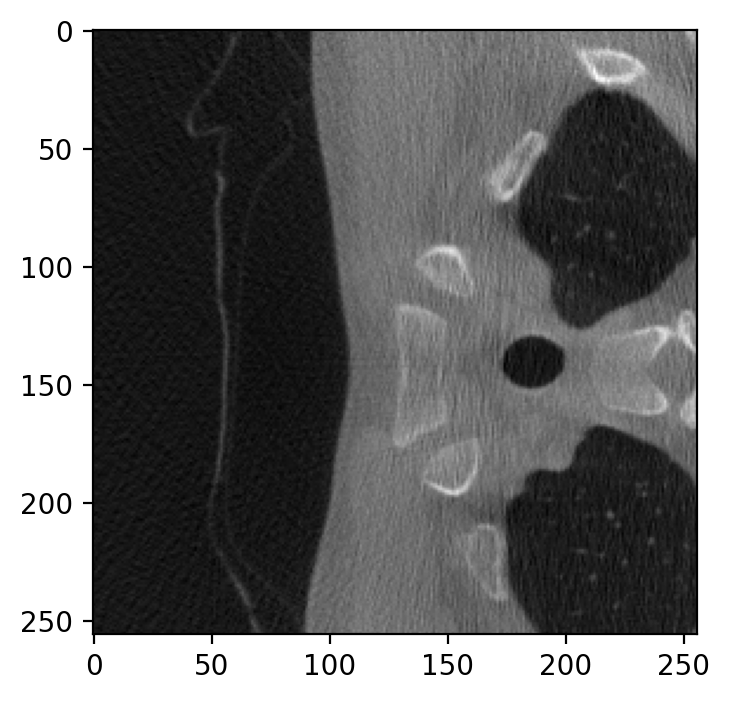

In [ ]:
#img, mask = data[0]
#img1 = np.squeeze(img)
#plt.figure(dpi =200)
#plt.imshow(img1, cmap = 'gray')

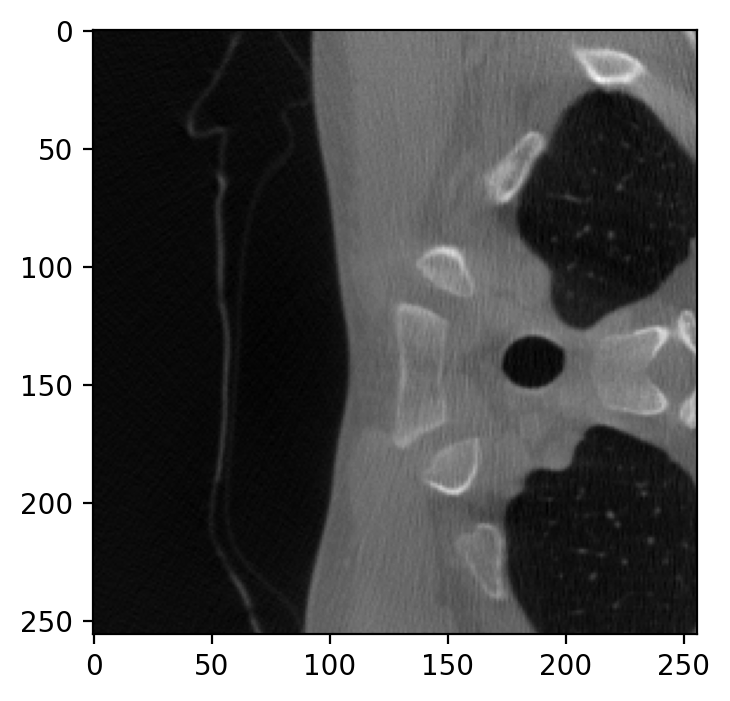

In [ ]:
#plt.figure(dpi =200)
#plt.imshow(mask, cmap = 'gray')

<class 'numpy.ndarray'>


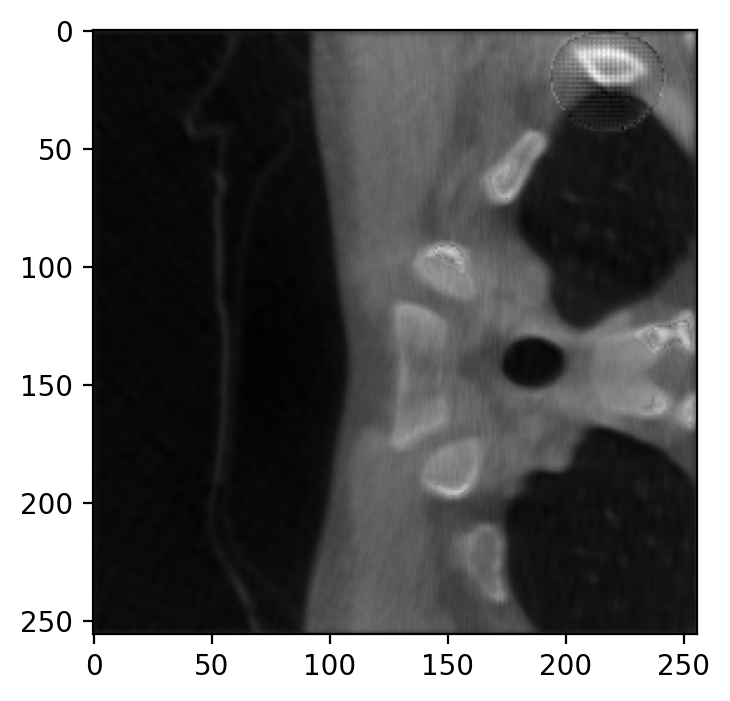

In [ ]:
#pred = model(torch.unsqueeze(img, 0))
#plt.figure(dpi=200)
#plt.imshow(torch.squeeze(pred).cpu().detach().numpy(), cmap = 'gray')

#print(type(torch.squeeze(pred).cpu().detach().numpy()))

In [ ]:
model, experiment_name = define_model(
    model_name='UNet',
    backbone=None,
    aspp=None,
    augment_data=True,
    optimizer='default', # use these options to experiment
    scheduler='default', # with optimizers and schedulers
    lr=0.001) # experiment to find the best LR
training_time = train(model, experiment_name, use_gpu=True)

print(f'Training time: {training_time:.3f} minutes')

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:611: UserWarning: Checkpoint directory /content/semantic_segmentation/logs/UNet_None_augment=True_aspp=None exists and is not empty.
  rank_zero_warn(f"Checkpoint directory {dirpath} exists and is not empty.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name | Type | Params
------------------------------
0 | net  | UNet | 16.5 M
------------------------------
16.5 M    Trainable params
0         Non-trainable params
16.5 M    Total params
65.965    Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!
torch.Size([1, 1, 256, 256]) torch.Size([1, 1, 256, 256])
!!!!!!VALIDATION FINISHED!!!!


/usr/local/lib/python3.7/dist-packages/piq/vsi.py:62: UserWarning: The original VSI supports only RGB images. The input images were converted to RGB by copying the grey channel 3 times.
  warnings.warn('The original VSI supports only RGB images. The input images were converted to RGB by copying '


Training: 0it [00:00, ?it/s]

Training time: 0.077 minutes


/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:724: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


After training, the loss curves and validation images with their segmentation masks can be viewed using the TensorBoard extension:

In [ ]:
%load_ext tensorboard
%tensorboard --logdir semantic_segmentation/logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
%load_ext tensorboard
%tensorboard --logdir semantic_segmentation/logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 8650), started 2:08:18 ago. (Use '!kill 8650' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
%load_ext tensorboard
%tensorboard --logdir semantic_segmentation/logs

In [ ]:
img, mask = data[0]
img1 = np.squeeze(img)
plt.figure(dpi =200)
plt.imshow(img1, cmap = 'gray')

In [ ]:
pred = model(torch.unsqueeze(img, 0))
plt.figure(dpi=200)
plt.imshow(torch.squeeze(pred).cpu().detach().numpy(), cmap = 'gray')

print(type(torch.squeeze(pred).cpu().detach().numpy()))

In [ ]:
plt.figure(dpi=200)
plt.imshow(mask, cmap = 'gray')

Inference time can be measured via the following function:

In [ ]:
def calc_inference_time(model, device, input_shape=(1000, 750), num_iters=100):
    timings = []

    for i in range(num_iters):
        x = torch.randn(1, 3, *input_shape).to(device)
        time_start = time.time()
        
        model(x)
        
        torch.cuda.synchronize()
        time_end = time.time()
        
        timings.append(time_end - time_start)

    return sum(timings) / len(timings) * 1e3


model, experiment_name = define_model(
    model_name='UNet',
    backbone=None,
    aspp=None,
    augment_data=True,
    optimizer='default', # use these options to experiment
    scheduler='default', # with optimizers and schedulers
    lr=0.001,
    checkpoint_name = 'epoch=19-mean_iou=0.000.ckpt') # experiment to find the best LR
#training_time = train(model, experiment_name, use_gpu=True)


Your trained weights are available in the `part1_semantic_segmentation/logs` folder. Inside, your experiment directory has a log file with the following mask: `{epoch:02d}-{mean_iou:.3f}.ckpt`. <font color='red'>**Make sure that you models satisfy the accuracy requirements, upload them to your personal Google Drive, and provide a link to google drive folder**.

In [ ]:
checkpoint_names = {
    'UNet_None_augment=False_aspp=None/epoch=99-mean_iou=0.242.ckpt', 
    'UNet_None_augment=True_aspp=None/epoch=84-mean_iou=0.256.ckpt', 
    'DeepLab_ResNet18_augment=True_aspp=False/epoch=59-mean_iou=0.312.ckpt',
    'DeepLab_ResNet18_augment=True_aspp=True/epoch=79-mean_iou=0.307.ckpt',  
    'DeepLab_vgg11_bn_augment=True_aspp=True/epoch=84-mean_iou=0.343.ckpt', 
    'DeepLab_mobilenet_v3_small_augment=True_aspp=True/epoch=69-mean_iou=0.321.ckpt',
}

# All the checkpoints could be found by the link:
#https://drive.google.com/drive/folders/1RbBwN_lTTHb9lKh8SUb6PqgUtbYjzPo-?usp=sharing

## Part 3. Report

You should have obtained 6 different models, which we will use for the comparison and evaluation. When asked to visualize specific loss curves, simply configure these plots in TensorBoard, screenshot, store them in the `report` folder, and load into Jupyter markdown:

`<img src="./part1_semantic_segmentation/report/<screenshot_filename>"/>`

If you have problems loading these images, try uploading them [here](https://imgur.com) and using a link as `src`. Do not forget to include the raw files in the `report` folder anyways.

You should make sure that your plots satisfy the following requirements:
- Each plot has a title,
- If there are multiple curves on one plot (or dots on the scatter plot), the plot legend should also be present,
- If the plot is not obtained using TensorBoard (Task 3), the axis should have names and ticks.

<font color='red'>**In this task, it is obligatory to provide accuracy plots on the training and validation datasets obtained during training, as well as examples of the work of each of the models on the images. Without plots, your work will get 0 points. Writing a report is just as important as writing code.**</font>

#### Task 1.
Visualize training loss and validation loss curves for UNet trained with and without data augmentation. What are the differences in the behavior of these curves between these experiments, and what are the reasons?

The blue curve - UNet_None_augment=True

And the orange - UNet_None_augment=False.

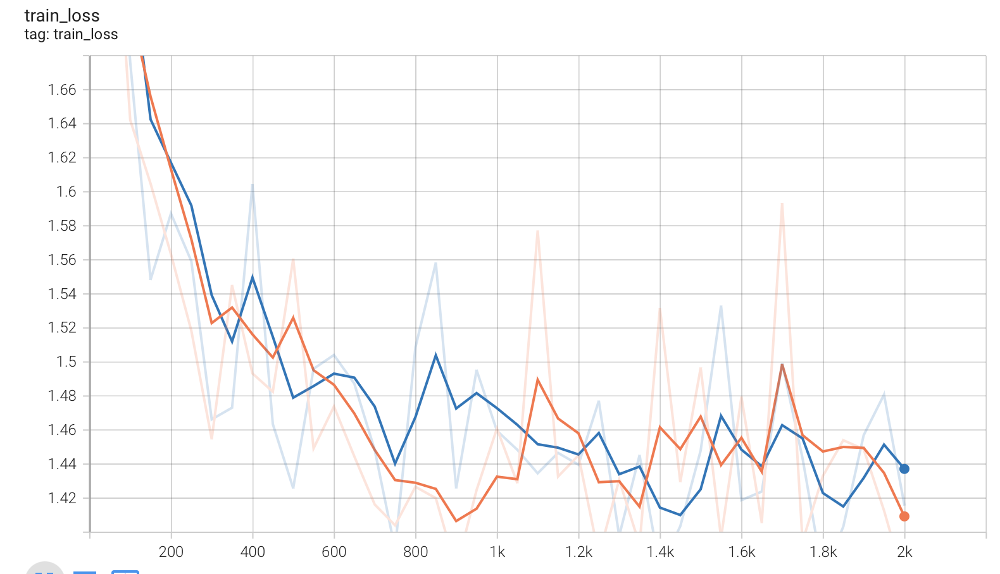

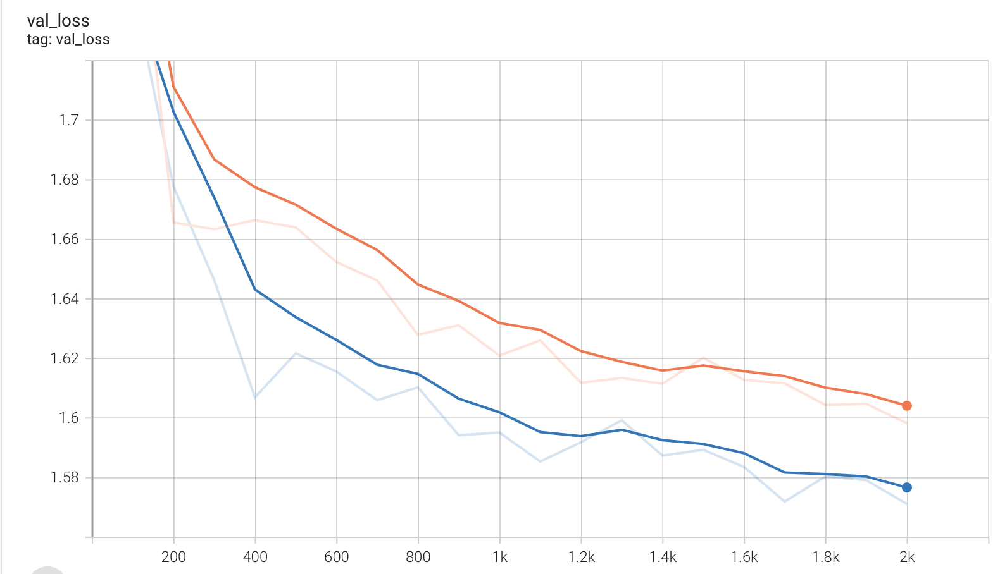

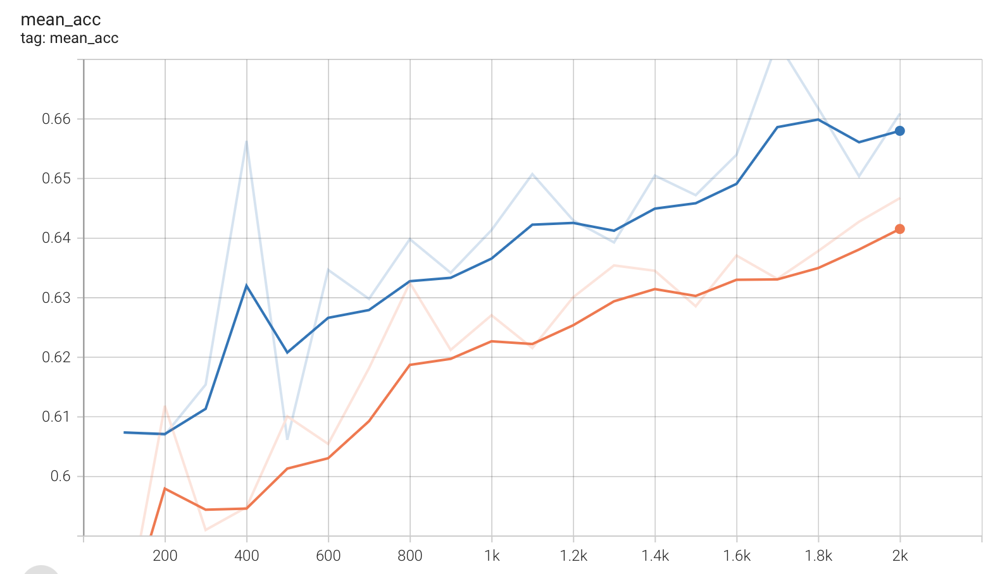

We could see here, that data augmentation helped. The val loss for UNet_None_augment=True is better than without augmentation, as well as mean accuracy.

#### Task 2.
Visualize training and validation loss curves for ResNet18 trained with and without ASPP. Which model performs better?

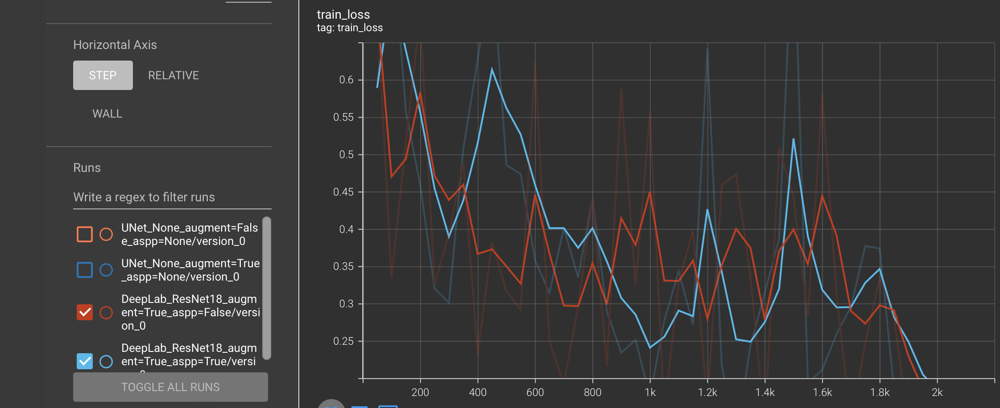

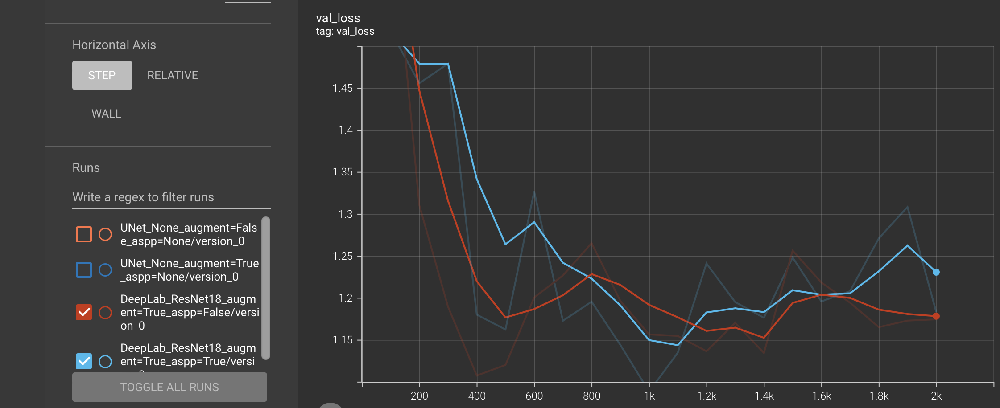

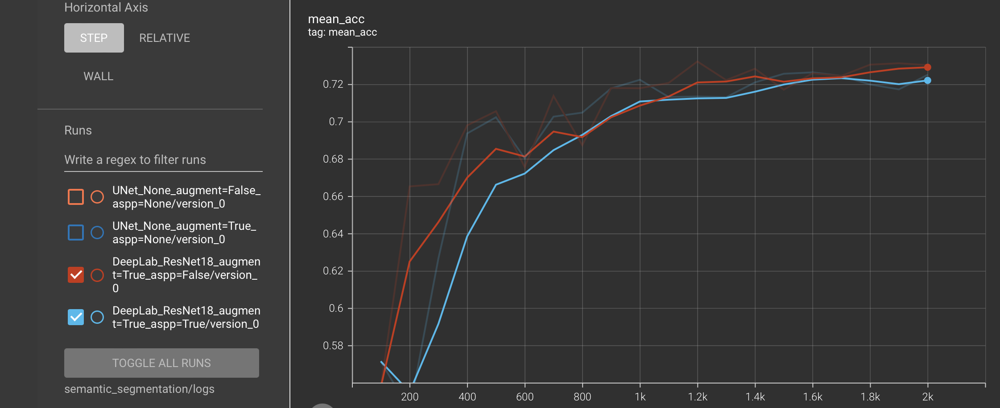

Here there is no difference. Resnet18 with and without ASPP modification shows practically the same results.

#### Task 3.
Compare **UNet** with augmentations and **DeepLab** with all backbones (only experiments with **ASPP**). To do that, put these models on three scatter plots. For the first plot, the x-axis is **training time** (in minutes), for the second plot, the x-axis is **inference time** (in milliseconds), and for the third plot, the x-axis is **model size** (in megabytes). The size of each model is printed by PyTorch Lightning. For all plots, the y-axis is the best **mIoU**. To clarify, each of the **4** requested models should be a single dot on each of these plots.

Which models are the most efficient with respect to each metric on the x-axes? For each of the evaluated models, rate its performance using their validation metrics, training and inference time, and model size. Also for each model explain what are its advantages, and how its performance could be improved?

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')
import numpy as np

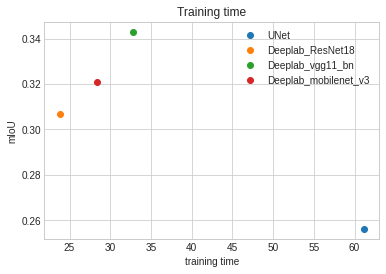

In [ ]:
x = [61.149, 23.777, 32.765, 28.415]
y = [0.256, 0.307, 0.343, 0.321]
for i, model in enumerate(['UNet', 'Deeplab_ResNet18', 'Deeplab_vgg11_bn', 'Deeplab_mobilenet_v3']):
  plt.plot(x[i], y[i], 'o', label="{0}".format(model))
  plt.legend(numpoints=1)
plt.xlabel('training time')
plt.ylabel('mIoU')
plt.title('Training time')
plt.show()

Here we could see, that Deeplab_ResNet18 shows the best performance according to training time. And UNet the worst.

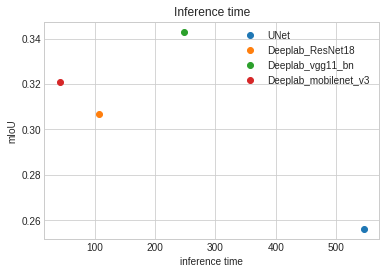

In [ ]:
x = [546.37, 106.994, 248.328, 41.381]
y = [0.256, 0.307, 0.343, 0.321]
for i, model in enumerate(['UNet', 'Deeplab_ResNet18', 'Deeplab_vgg11_bn', 'Deeplab_mobilenet_v3']):
  plt.plot(x[i], y[i], 'o', label="{0}".format(model))
  plt.legend()
plt.xlabel('inference time')
plt.ylabel('mIoU')
plt.title('Inference time')
plt.show()

As to the inference time - again UNet shows the worst performance. And DeepLab_mobilenet_v3 with DeepLab_Resnet18 the best.

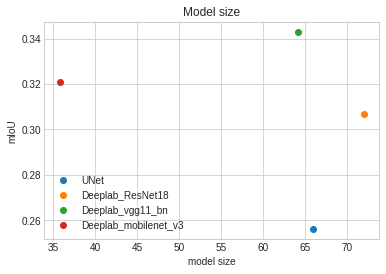

In [ ]:
x = [65.968, 72.006, 64.204, 35.745]
y = [0.256, 0.307, 0.343, 0.321]
for i, model in enumerate(['UNet', 'Deeplab_ResNet18', 'Deeplab_vgg11_bn', 'Deeplab_mobilenet_v3']):
  plt.plot(x[i], y[i], 'o', label="{0}".format(model))
  plt.legend()
plt.xlabel('model size')
plt.ylabel('mIoU')
plt.title('Model size')
plt.show()

Here we could see, that DeepLab_mobilenet_v3 has the smallest size but mIoU is worse than for Deep_Lab_vgg11_bn. 

All in all, the DeepLab with VGG backbone shows the best performanse according to mIoU and it is in the middle among other models for all the provided metrics (model size, training time and inference time). 
Yet MobileNet is also worth mentioning, because it is light, yet has still good perfomance.
Unet is just a baseline, we should not expect the best performance from it.

#### Task 4.

Pick the best model according to **mIoU** and look at the visualized predictions on the validation set in the TensorBoard. For each segmentation class, find the good examples (if they are available), and the failure cases. Provide the zoomed-in examples and their analysis below. Please do not attach full validation images, only the areas of interest which you should crop manually.

Let's see some examples of DeepLab with VGG backbone.

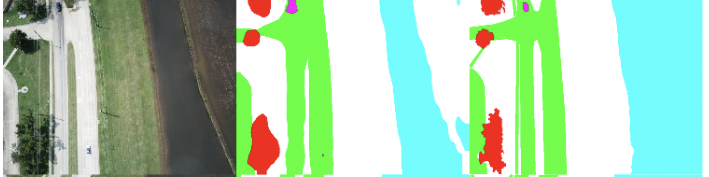

Here is a good example with practically ideal result. There is a good match between the mask and prediction.

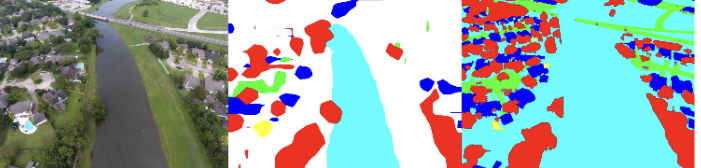

Here we could see some mistakes, discrepancy between the mask and the prediction.

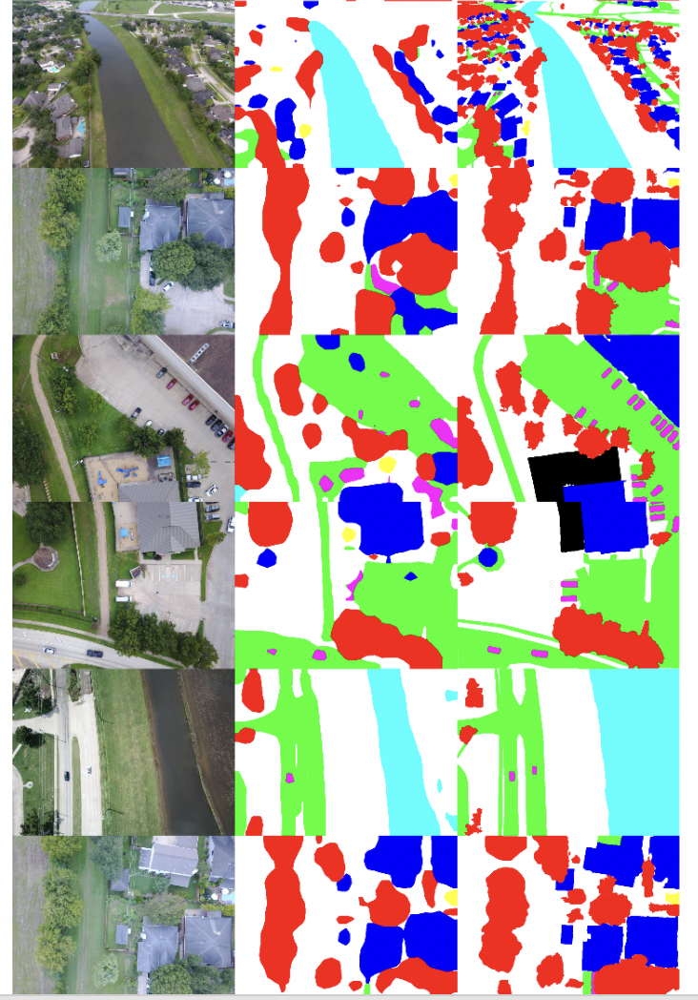

And here some more examples. 
All in all, the results are really good despite small discrepancy in some examples.

**<font color='red'>Before the submission please:**

*   comment all strings that start with '!' symbol
*   convert your notebook to .py file and check that it runs correctly.
* upload both .ipynb and .py to Canvas


  How to get .py file in Colab: File -> Download -> Download .py</font>

In [ ]:
#Left side menu in Colab -> Files -> Upload your script and then check.
#!python hw2_semantic_segmentation_Kolomeytseva_Katerina_attempt_1.py
# comment this block after checking
# You can replace TODO strings to None

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:608: UserWarning: Checkpoint directory /content/semantic_segmentation/logs/UNet_None_augment=False_aspp=None exists and is not empty.
  rank_zero_warn(f"Checkpoint directory {dirpath} exists and is not empty.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name | Type | Params
------------------------------
0 | net  | UNet | 16.5 M
------------------------------
16.5 M    Trainable params
0         Non-trainable params
16.5 M    Total params
65.968    Total estimated model params size (MB)
Sanity Checking: 0it [00:00, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this D